# Downloading Dataset

In [ ]:
import os
import sys
from tempfile import NamedTemporaryFile
from urllib.request import urlopen
from urllib.parse import unquote, urlparse
from urllib.error import HTTPError
from zipfile import ZipFile
import tarfile
import shutil

In [ ]:
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torchvision.utils import make_grid
import torch.optim as optim
from tqdm import tqdm
import matplotlib.pyplot as plt
import numpy as np
from zipfile import ZipFile
import os

device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Reading and Transforming Dataset

In [ ]:
image_size = 64
#dataroot = '/kaggle/input/animefacedataset'
#dset = datasets.ImageFolder(root=dataroot,
#                           transform=transforms.Compose([
#                               transforms.Resize(image_size),
#                               transforms.CenterCrop(image_size),
#                               transforms.ToTensor(),
#                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
#                           ]))
#dataloader = torch.utils.data.DataLoader(dset, batch_size=128,
#                                         shuffle=True, num_workers=6)
dataroot = './anime_faces/'
dset = datasets.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
dataloader = torch.utils.data.DataLoader(dset, batch_size=128,
                                         shuffle=True, num_workers=6)

# Visualizing Dataset

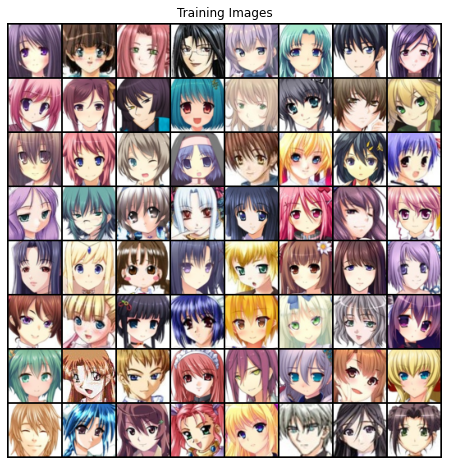

In [ ]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

# Deep Generative Convolutional Network Baseline Implementation

**Generator Architecture**

In [ ]:
class GeneratorNetwork(nn.Module):
    def __init__(self,
                 depth=128,
                 k=4
                ):
        super(GeneratorNetwork, self).__init__()

        self.layers = nn.Sequential(
            nn.ConvTranspose2d(100, depth*8, (k, k), stride=1, bias=False),
            nn.ReLU(),
            nn.BatchNorm2d(depth*8),
            nn.ConvTranspose2d(depth*8, depth*4, (k, k), padding=1, stride=2, bias=False),
            nn.ReLU(),
            nn.BatchNorm2d(depth*4),
            nn.ConvTranspose2d(depth*4, depth*2, (k, k), padding=1, stride=2, bias=False),
            nn.ReLU(),
            nn.BatchNorm2d(depth*2),
            nn.ConvTranspose2d(depth*2, depth, (k, k), padding=1, stride=2,  bias=False),
            nn.ReLU(),
            nn.BatchNorm2d(depth),
            nn.ConvTranspose2d(depth, 3, (k, k), padding=1, stride=2, bias=False)
        )
        self.tanh = nn.Tanh()

    def forward(self, x):
        score = self.tanh(self.layers(x))
        return score


**Discriminator Architecture**

In [ ]:
class DiscriminatorNetwork(nn.Module):
    def __init__(self,
                 depth=128,
                 k=4
                ):
        super(DiscriminatorNetwork, self).__init__()

        self.layers = nn.Sequential(
            nn.Conv2d(3, depth, (k, k), padding=1, stride=2, bias=False),
            nn.LeakyReLU(0.2),
            nn.Conv2d(depth, depth*2, (k, k), padding=1, stride=2, bias=False),
            nn.LeakyReLU(0.2),
            nn.BatchNorm2d(depth*2),
            nn.Conv2d(depth*2, depth*4, (k, k), padding=1, stride=2, bias=False),
            nn.LeakyReLU(0.2),
            nn.BatchNorm2d(depth*4),
            nn.Conv2d(depth*4, depth*8, (k, k), padding=1, stride=2, bias=False),
            nn.LeakyReLU(0.2),
            nn.BatchNorm2d(depth*8),
            nn.Conv2d(depth*8, 1, (k, k), stride=2, bias=False)
        )

    def forward(self, x):
        score = self.layers(x)
        return score


**DCGAN Training**

In [ ]:
class DCGAN(nn.Module):
    def __init__(self):
        super(DCGAN, self).__init__()
        self.generator      = GeneratorNetwork()
        self.discriminator  = DiscriminatorNetwork()
        self.apply(initialize_weights)

    def forward(self, x):
        return self.generator(x)

def initialize_weights(module):
    module_type = module.__class__.__name__
    print(module_type)

In [ ]:
gen = GeneratorNetwork().to(device)
disc = DiscriminatorNetwork().to(device)

criterion = nn.BCEWithLogitsLoss()
gen_optimizer = optim.Adam(gen.parameters(), lr=0.0004, betas=(0.5, 0.999))
disc_optimizer = optim.Adam(disc.parameters(), lr=0.0004, betas=(0.5, 0.999))

epochs = 15
disc_steps = 5

gen_loss = []
disc_loss = []

gen_images = []

for epoch in range(epochs):
    for i, batch in enumerate(tqdm(dataloader), 0):
        #### Training Discriminator ####
        disc.zero_grad()
        data = batch[0].to(device)
        label = torch.full((data.size(0),), 1., dtype=torch.float, device=device)
        output = disc(data).view(-1)
        real_loss = criterion(output, label)
        real_loss.backward()

        noise = torch.randn(data.size(0), 100, 1, 1, device=device)
        gen_output = gen(noise)
        label.fill_(0.)
        output = disc(gen_output.detach()).view(-1)
        fake_loss = criterion(output, label)
        fake_loss.backward()

        disc_optimizer.step()

        #### Training Generator ####
        gen.zero_grad()
        label.fill_(1.)
        output = disc(gen_output).view(-1)
        g_loss = criterion(output, label)
        g_loss.backward()
        gen_optimizer.step()
        gen_loss.append(g_loss.item())
        disc_loss.append((real_loss.item()+fake_loss.item()))

    with torch.no_grad():
        noise = torch.randn(64, 100, 1, 1, device=device)
        fake_images = gen(noise).detach().cpu()
        gen_images.append(make_grid(fake_images, padding=2, normalize=True))

100%|██████████| 497/497 [01:59<00:00,  4.17it/s]


**Displaying Results**

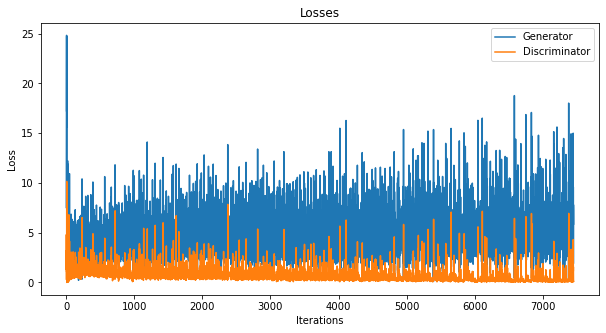

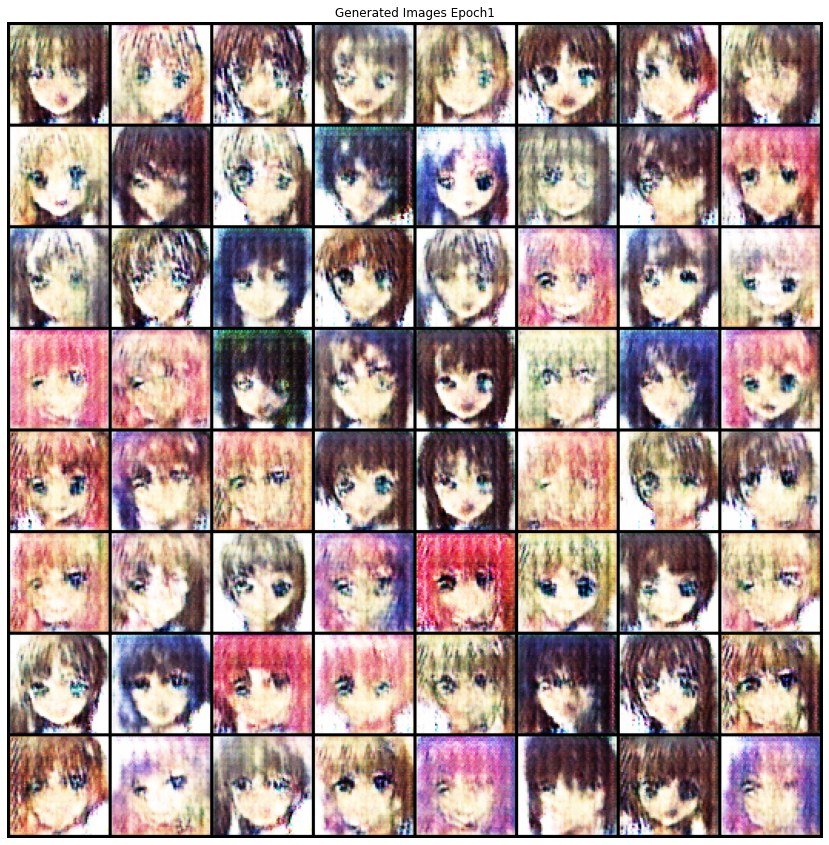

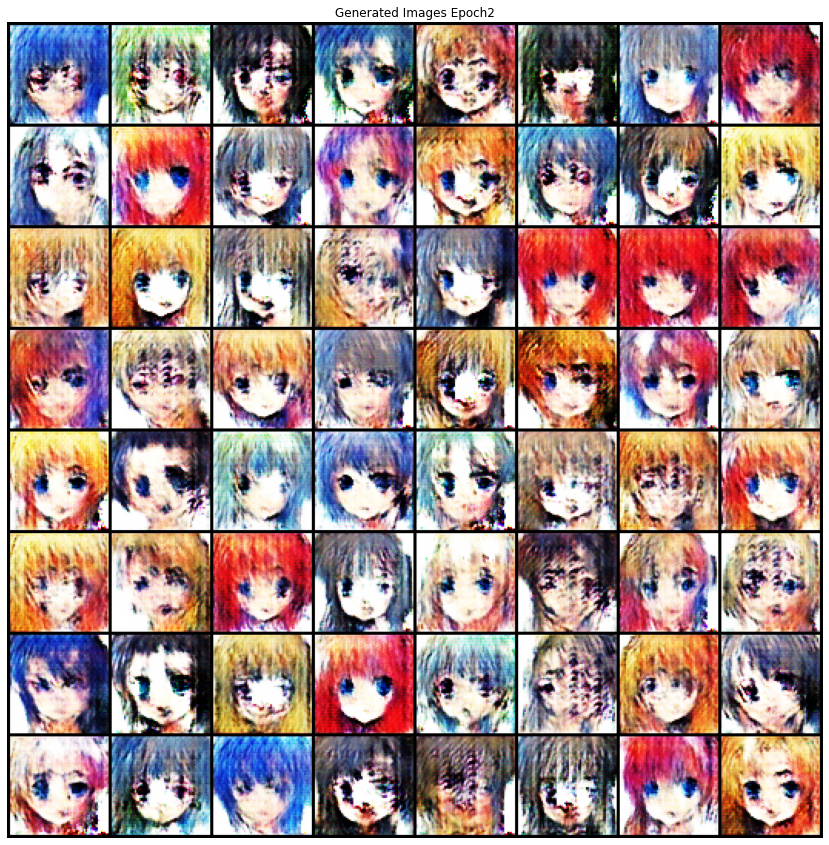

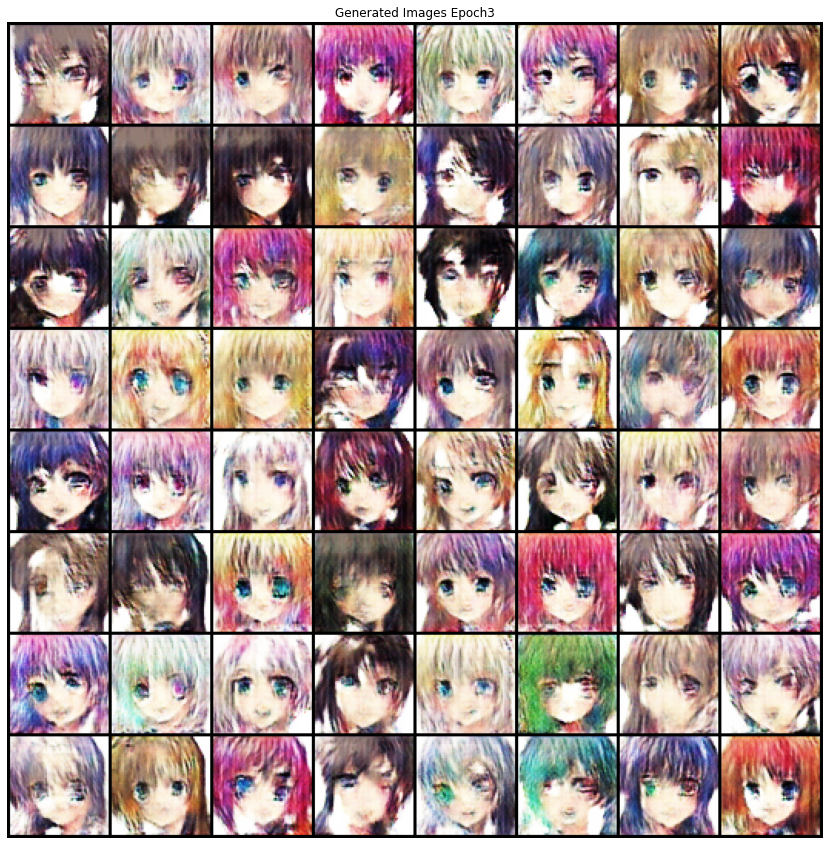

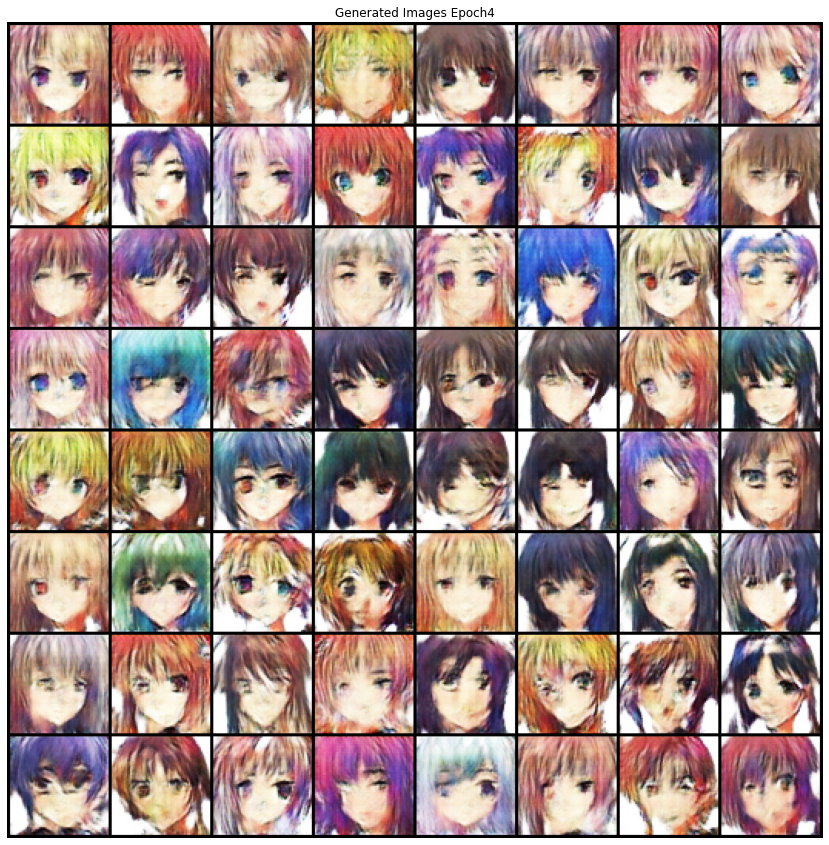

...

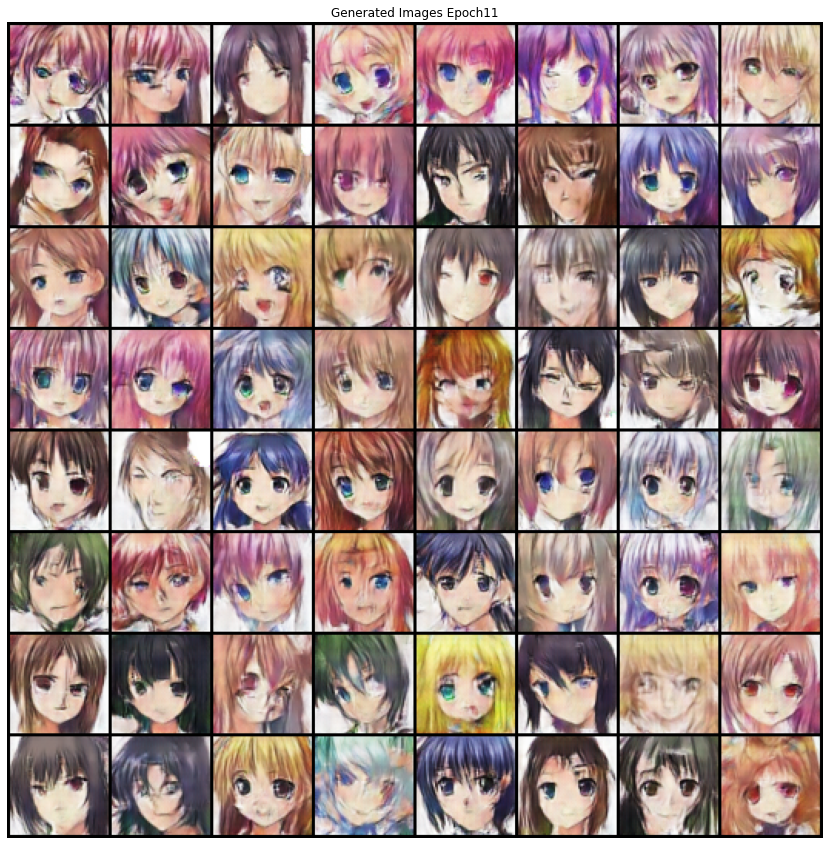

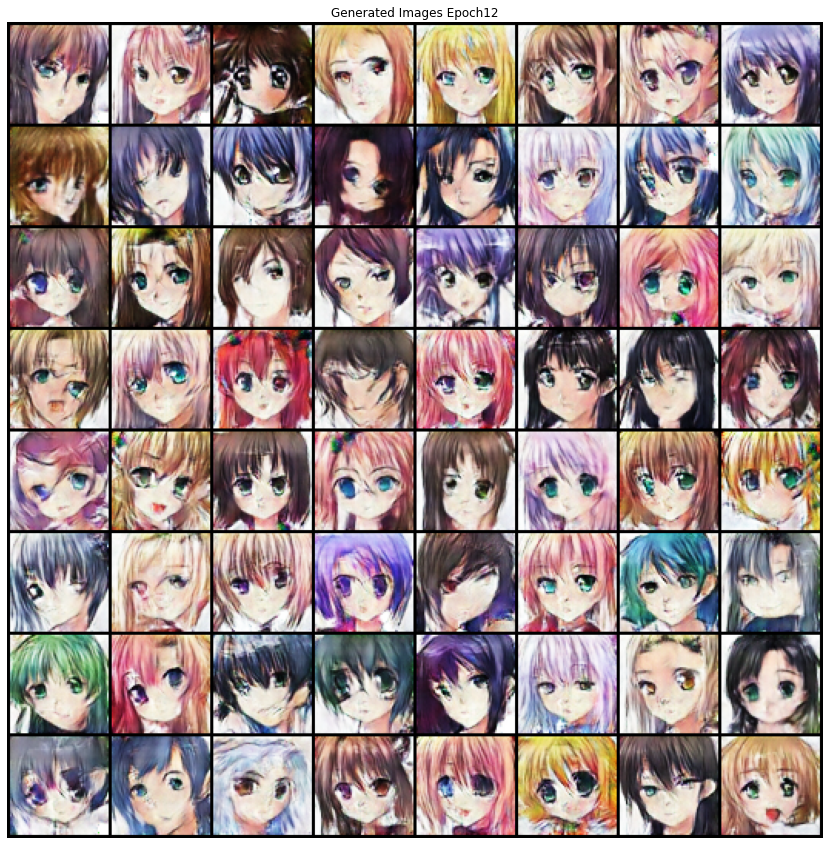

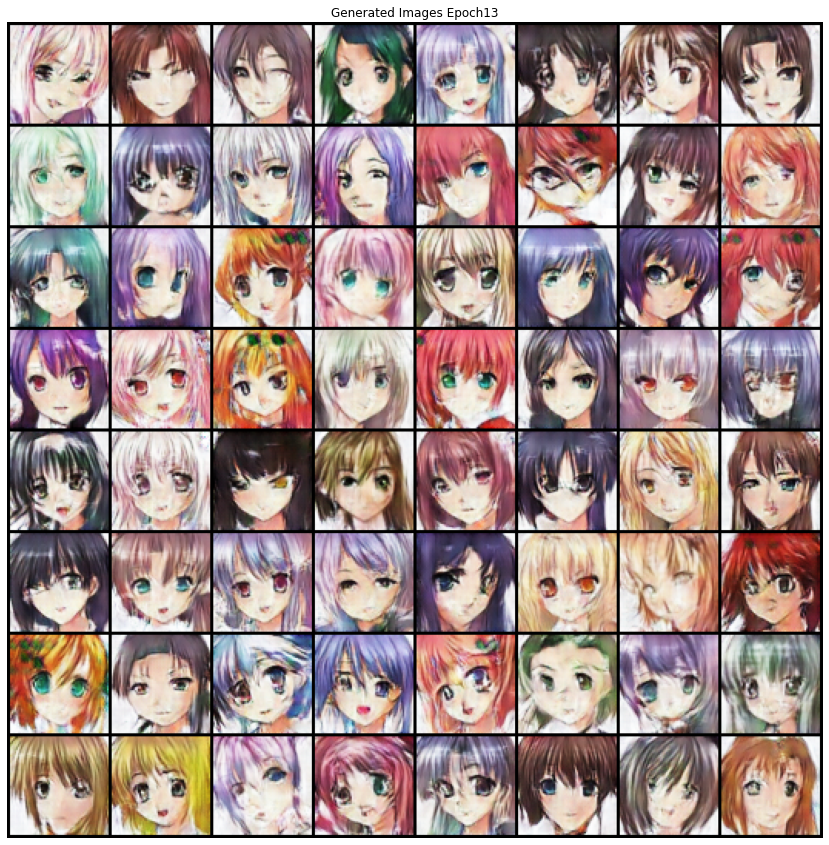

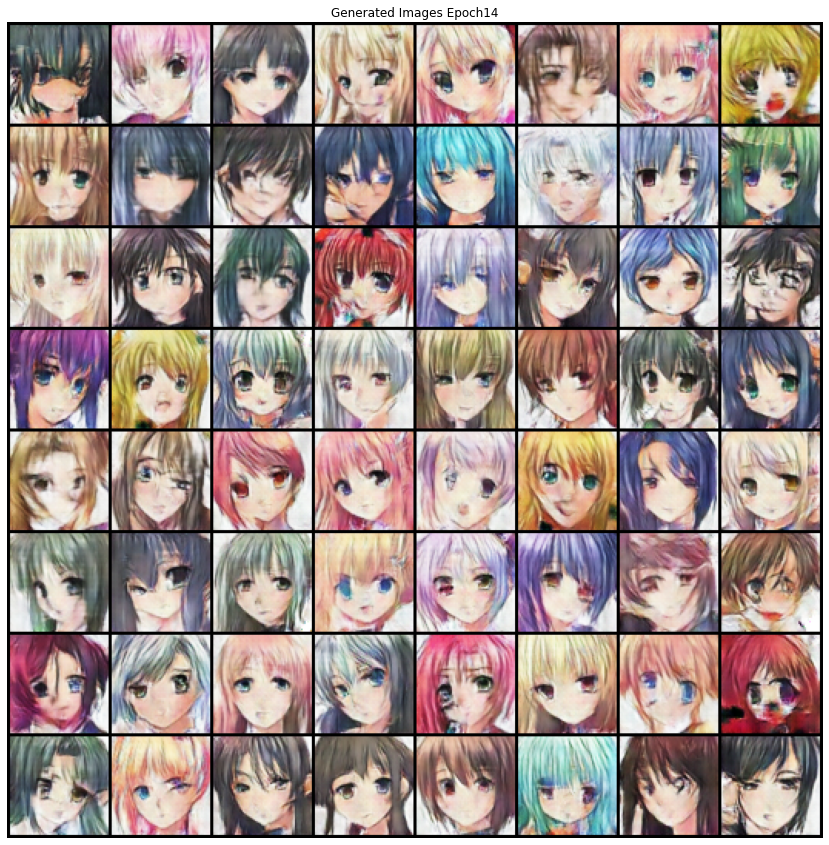

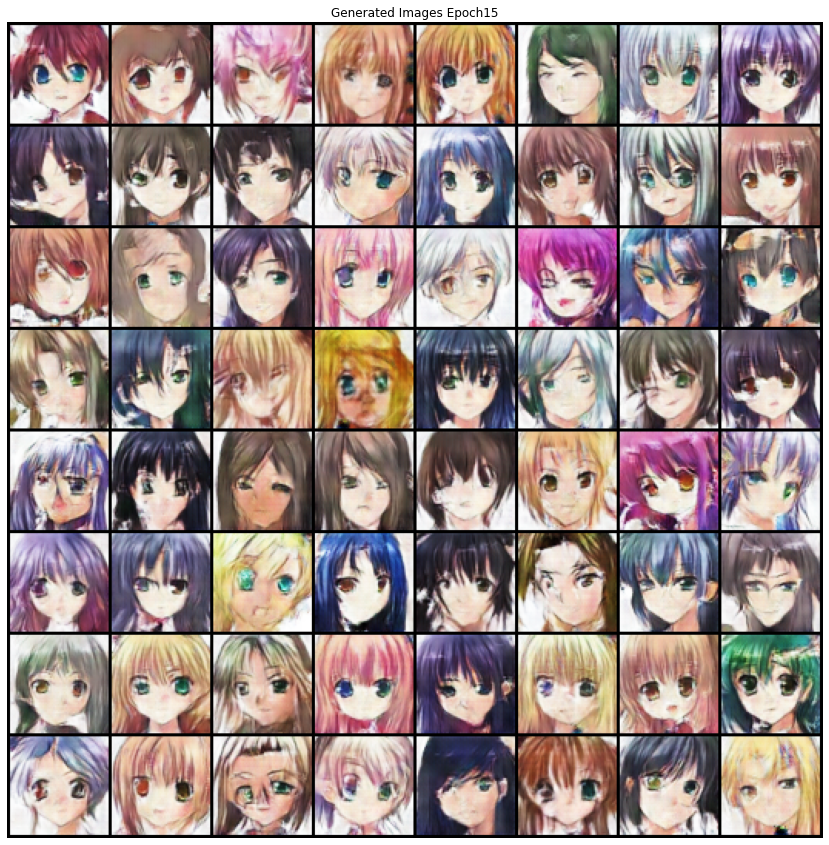

In [ ]:
plt.figure(figsize=(10,5))
plt.title('Losses')
plt.plot(gen_loss, label="Generator")
plt.plot(disc_loss, label="Discriminator")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

for i, img in enumerate(gen_images):
    plt.figure(figsize=(15,15))
    plt.axis('off')
    plt.title(f'Generated Images Epoch{i+1}')
    plt.imshow(np.transpose(img, (1,2,0)))
    plt.show()

#DCGAN with spectral norm

**Modified Architecture**

In [ ]:
from torch.nn.utils import spectral_norm

**Generator Architecture**

In [ ]:
class GeneratorNetwork(nn.Module):
    def __init__(self,
                 depth=128,
                 k=4 #Kernel Size
                ):
        super(GeneratorNetwork, self).__init__()

        self.layers = nn.Sequential(
            nn.ConvTranspose2d(100, depth*8, (k, k), stride=1, bias=False),
            nn.ReLU(),
            nn.BatchNorm2d(depth*8),
            spectral_norm(nn.ConvTranspose2d(depth*8, depth*4, (k, k), padding=1, stride=2, bias=False)),
            nn.ReLU(),
            spectral_norm(nn.ConvTranspose2d(depth*4, depth*2, (k, k), padding=1, stride=2, bias=False)),
            nn.ReLU(),
            nn.ConvTranspose2d(depth*2, depth, (k, k), padding=1, stride=2,  bias=False),
            nn.ReLU(),
            nn.BatchNorm2d(depth),
            nn.ConvTranspose2d(depth, 3, (k, k), padding=1, stride=2, bias=False)
        )
        self.tanh = nn.Tanh()

    def forward(self, x):
        score = self.tanh(self.layers(x))
        return score

**Discriminator Architecture**

In [ ]:
class DiscriminatorNetwork(nn.Module):
    def __init__(self,
                 depth=128,
                 k=4
                ):
        super(DiscriminatorNetwork, self).__init__()

        self.layers = nn.Sequential(
            spectral_norm(nn.Conv2d(3, depth, (k, k), padding=1, stride=2, bias=False)),
            nn.LeakyReLU(0.2),
            nn.Conv2d(depth, depth*2, (k, k), padding=1, stride=2, bias=False),
            nn.LeakyReLU(0.2),
            nn.BatchNorm2d(depth*2),
            spectral_norm(nn.Conv2d(depth*2, depth*4, (k, k), padding=1, stride=2, bias=False)),
            nn.LeakyReLU(0.2),
            nn.BatchNorm2d(depth*4),
            spectral_norm(nn.Conv2d(depth*4, depth*8, (k, k), padding=1, stride=2, bias=False)),
            nn.LeakyReLU(0.2),
            nn.BatchNorm2d(depth*8),
            nn.Conv2d(depth*8, 1, (k, k), stride=2, bias=False)
        )

    def forward(self, x):
        score = self.layers(x)
        return score

**Training Modified Architecture**

In [ ]:
class DCGAN(nn.Module):
    def __init__(self):
        super(DCGAN, self).__init__()
        self.generator      = GeneratorNetwork()
        self.discriminator  = DiscriminatorNetwork()
        self.apply(initialize_weights)

    def forward(self, x):
        return self.generator(x)

def initialize_weights(module):
    module_type = module.__class__.__name__
    print(module_type)

In [ ]:
gen = GeneratorNetwork().to(device)
disc = DiscriminatorNetwork().to(device)

criterion = nn.BCEWithLogitsLoss()
gen_optimizer = optim.Adam(gen.parameters(), lr=0.0004, betas=(0.5, 0.999))
disc_optimizer = optim.Adam(disc.parameters(), lr=0.0004, betas=(0.5, 0.999))

epochs = 25
disc_steps = 5

gen_loss = []
disc_loss = []

gen_images = []

for epoch in range(epochs):
    for i, batch in enumerate(tqdm(dataloader), 0):
        #### Training Discriminator ####
        disc.zero_grad()
        data = batch[0].to(device)
        label = torch.full((data.size(0),), 1., dtype=torch.float, device=device)
        output = disc(data).view(-1)
        real_loss = criterion(output, label)
        real_loss.backward()

        noise = torch.randn(data.size(0), 100, 1, 1, device=device)
        gen_output = gen(noise)
        label.fill_(0.)
        output = disc(gen_output.detach()).view(-1)
        fake_loss = criterion(output, label)
        fake_loss.backward()

        disc_optimizer.step()

        #### Training Generator ####
        gen.zero_grad()
        label.fill_(1.)
        output = disc(gen_output).view(-1)
        g_loss = criterion(output, label)
        g_loss.backward()
        gen_optimizer.step()
        gen_loss.append(g_loss.item())
        disc_loss.append((real_loss.item()+fake_loss.item()))

    with torch.no_grad():
        noise = torch.randn(64, 100, 1, 1, device=device)
        fake_images = gen(noise).detach().cpu()
        gen_images.append(make_grid(fake_images, padding=2, normalize=True))

 55%|█████▍    | 273/497 [01:08<00:55,  4.05it/s]

**Displaying Results**

In [ ]:
plt.figure(figsize=(10,5))
plt.title('Losses')
plt.plot(gen_loss, label="Generator")
plt.plot(disc_loss, label="Discriminator")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

for i, img in enumerate(gen_images):
    plt.figure(figsize=(15,15))
    plt.axis('off')
    plt.title(f'Generated Images Epoch{i+1}')
    plt.imshow(np.transpose(img, (1,2,0)))
    plt.show()

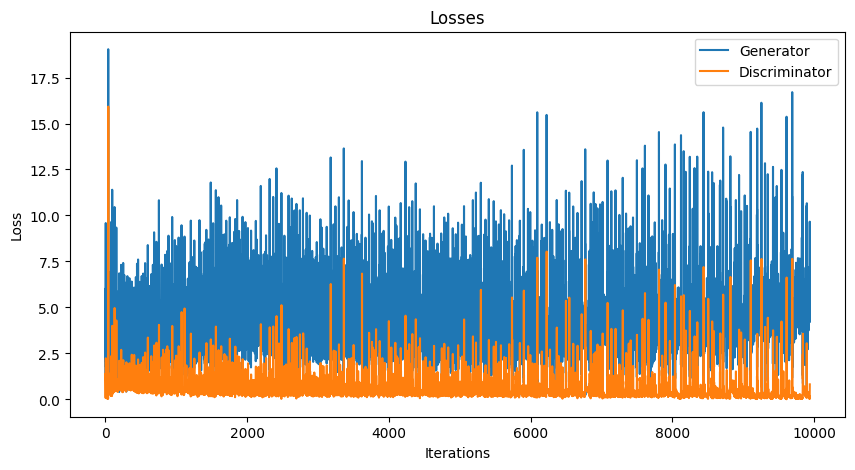

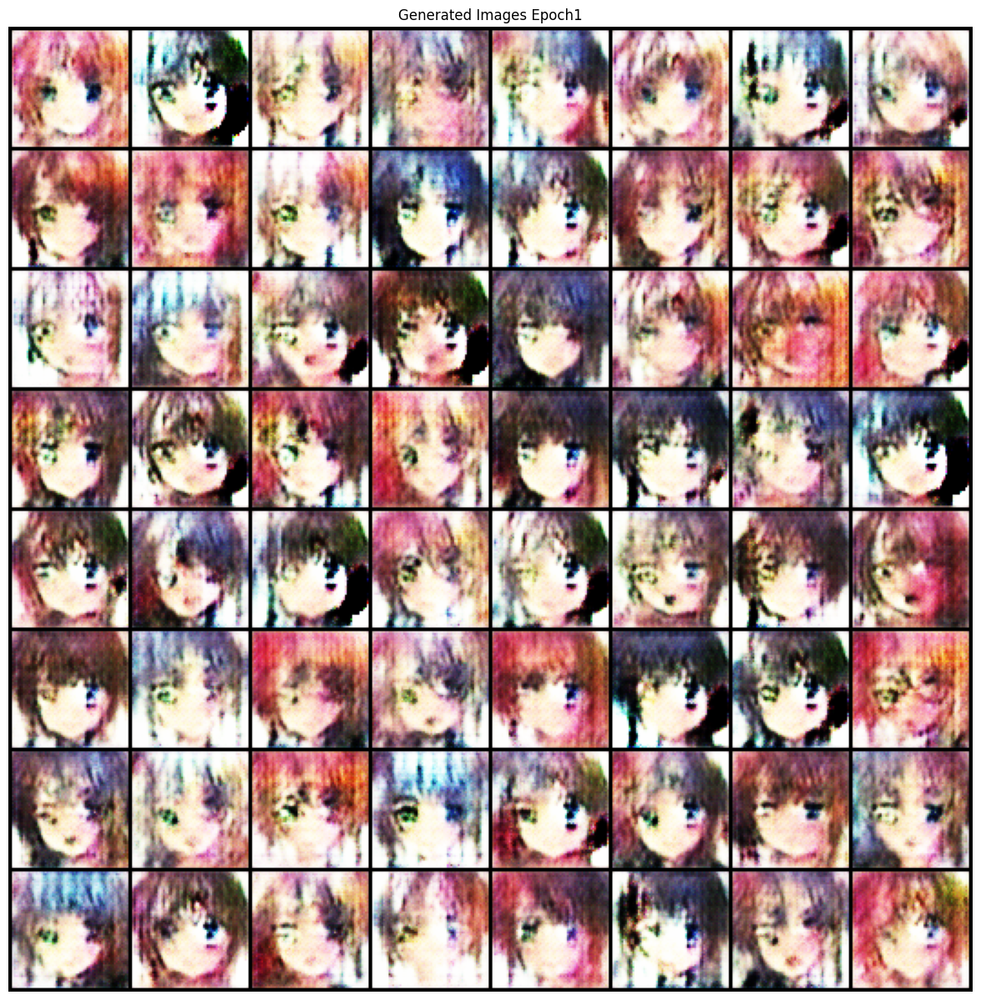

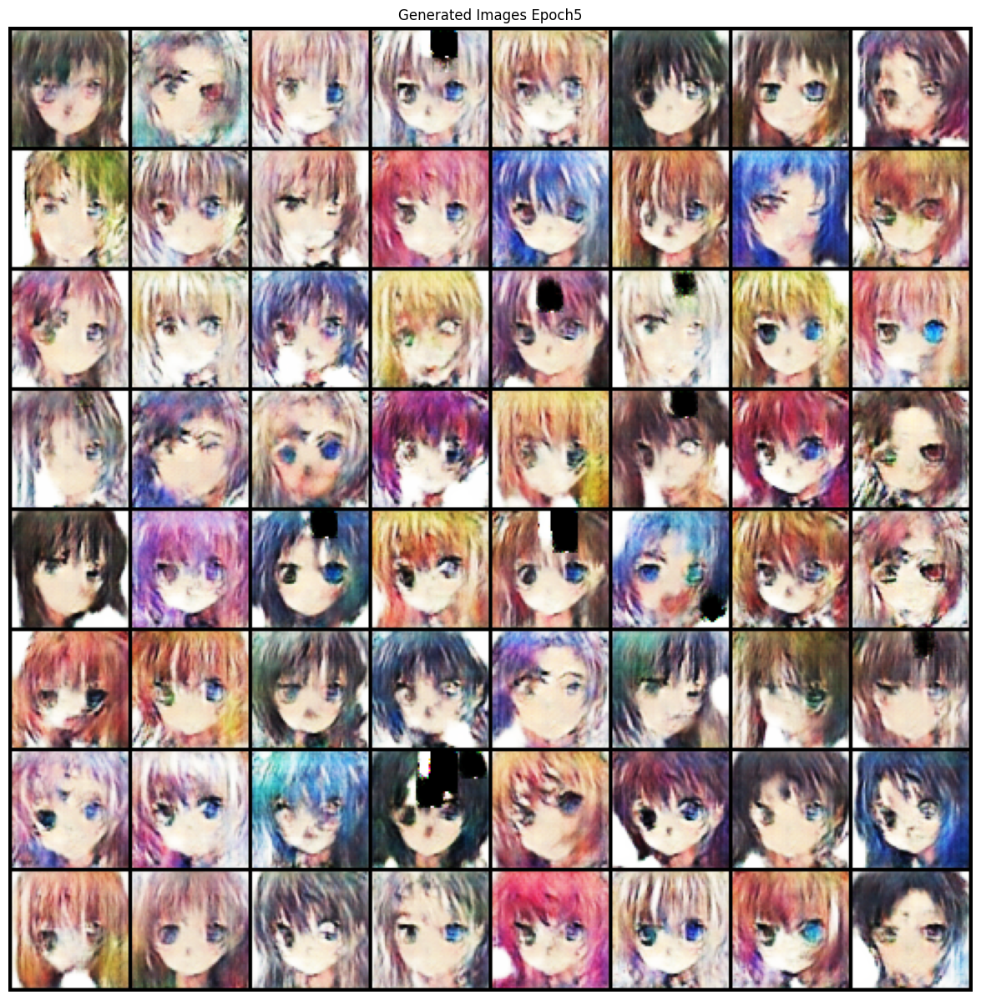

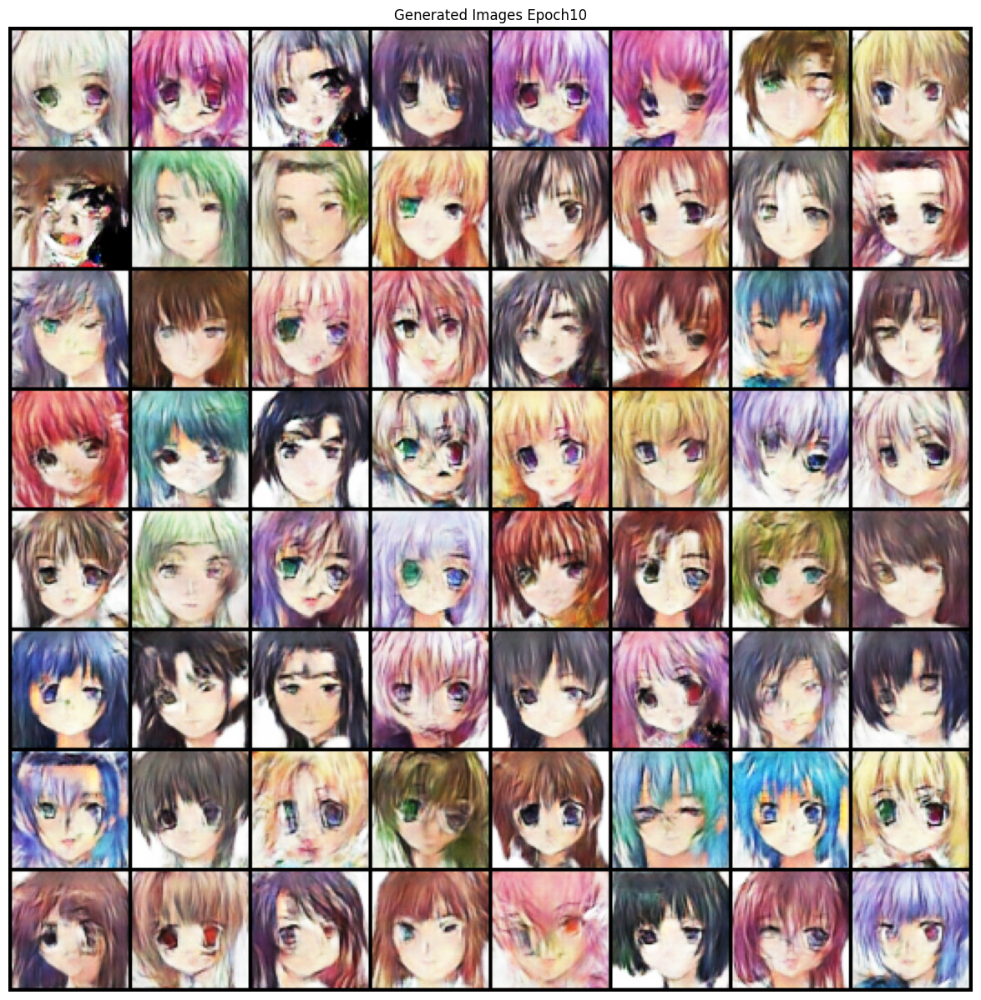

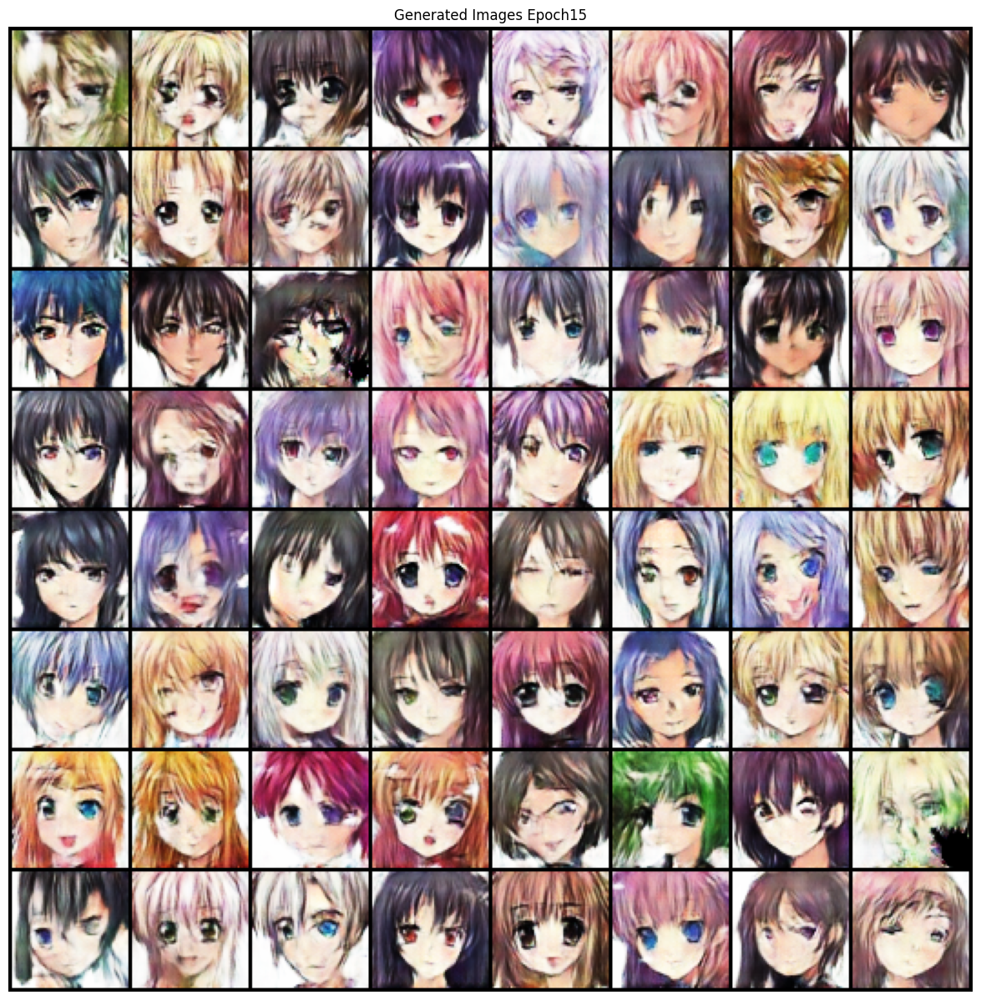

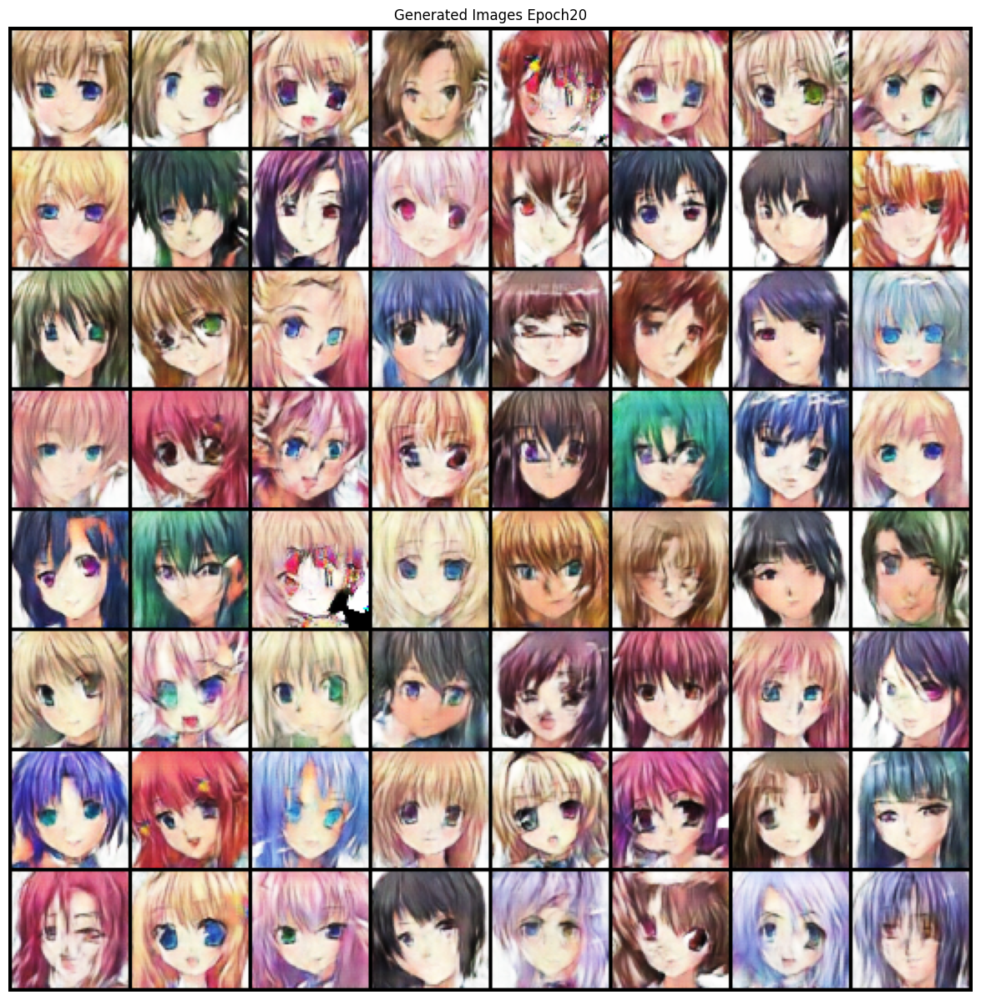

**Classifying real and fake images (Experimentation)**

In [ ]:
# from torchvision.utils import make_grid
# from sklearn.neighbors import KNeighborsClassifier
# from sklearn.metrics import accuracy_score
# from torchvision import datasets, transforms
# from torch.utils.data import DataLoader, Dataset, ConcatDataset
# import torch
# import numpy as np
# image_size=64
# transform = transforms.Compose([
#     transforms.Resize(image_size),
#     transforms.CenterCrop(image_size),
#     transforms.ToTensor(),
#     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
# ])

# subset_size = 5000

# subset_indices = torch.randperm(len(dset))[:subset_size]

# real_dset = Subset(real_dset, subset_indices)

# gen_images = []
# with torch.no_grad():
#     noise = torch.randn(64, 5000, 1, 1, device=device)
#     gen_images = gen(noise).detach().cpu()
#     gen_images.append(gen_images)

# gen_labels = torch.ones(len(gen_images))

# class Classification_Fake(Dataset):
#     def __init__(self, images, labels):
#         self.images = images
#         self.labels = labels

#     def __len__(self):
#         return len(self.images)

#     def __getitem__(self, idx):
#         image = self.images[idx]
#         label = self.labels[idx]
#         return image, label

# gen_dataset = Classification_Fake(torch.cat(gen_images), gen_labels)

# all_dataset = ConcatDataset([real_dset, gen_dataset])

# real_labels = torch.zeros(len(real_dset))

# all_labels = torch.cat([real_labels, gen_labels])
# print('Creating Combined Dataset')
# combined_data = []
# for image, _ in all_dataset:
#     combined_data.append(image.view(-1).numpy())
# combined_data = np.stack(combined_data)

# def knn_accuracy(data, labels, k=5):
#     print('Fitting Classifier')
#     knn = KNeighborsClassifier(n_neighbors=k)
#     knn.fit(data, labels)
#     pred_labels = knn.predict(data)
#     accuracy = accuracy_score(labels, pred_labels)
#     return accuracy
# print('Starting Training')
# accuracy = knn_accuracy(combined_data, all_labels)
# print(f"Nearest Neighbor Accuracy (k=5): {accuracy:.4f}")